# **Importing Dependencies & loading model**

In [ ]:
!pip install -q transformers accelerate peft diffusers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 297.6/297.6 kB 4.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 199.1/199.1 kB 7.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.0/2.0 MB 14.9 MB/s eta 0:00:00


In [ ]:
from diffusers import StableDiffusionPipeline
from diffusers.utils import make_image_grid
from diffusers import AutoPipelineForText2Image
import torch

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
base_large_param_model_path = "/content/drive/MyDrive/Datasets/base_sd_model"
lora_weight_path = "/content/drive/MyDrive/Datasets/lora_model_weights"
lora_pipeline = AutoPipelineForText2Image.from_pretrained(base_large_param_model_path, torch_dtype=torch.float16).to("cuda")
lora_pipeline.load_lora_weights(lora_weight_path, weight_name="pytorch_lora_weights.safetensors")

Loading pipeline components...:   0%|          | 0/6 [00:00<?, ?it/s]

# **Fine Tuned Lora Based Model**

In [ ]:
def generated_image(pipeline, prompt, scale = 1, num_inference_steps = 50, resize = 512):
  "For Single Prompt"
  image_lora = pipeline(prompt, num_inference_steps=num_inference_steps, cross_attention_kwargs={"scale": scale}).images[0]
  print(f"Prompt : {prompt}")
  return make_image_grid([image_lora], rows=1, cols=1, resize = resize)

  0%|          | 0/50 [00:00<?, ?it/s]

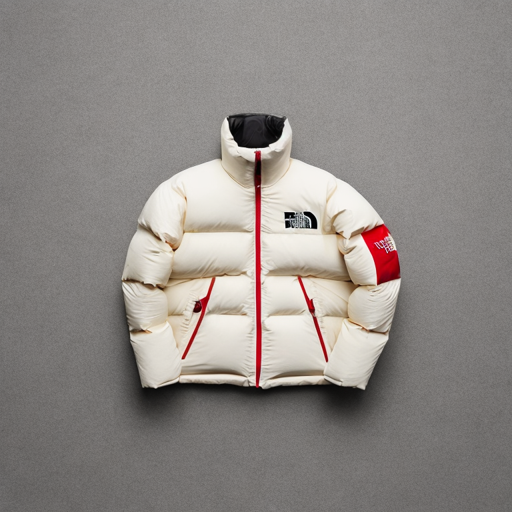

In [ ]:
prompt = "outer, The North Face x Supreme White Label Nuptse Down Jacket Cream, a photography of a white puffer jacket with a red box logo on the front."
img = lora_pipeline(prompt, num_inference_steps=50).images[0]
make_image_grid([img], rows=1, cols=1, resize=512)

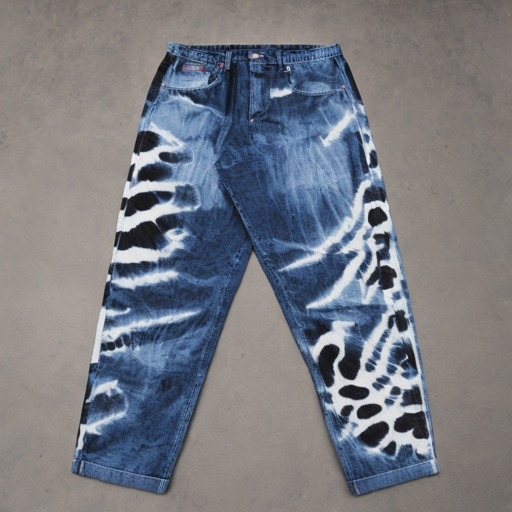

In [ ]:
prompt = "bottom, Supreme Animal Print Baggy Jean Washed Indigo - 23FW, a photography of a dark blue jean with an animal printing on."
img = lora_pipeline(prompt, num_inference_steps=50).images[0]
make_image_grid([img], rows=1, cols=1, resize=512)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : khaki short


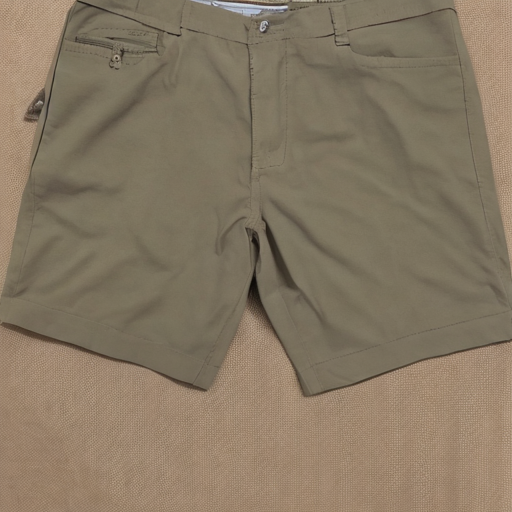

In [ ]:
prompt = "khaki short"
generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : Leggings


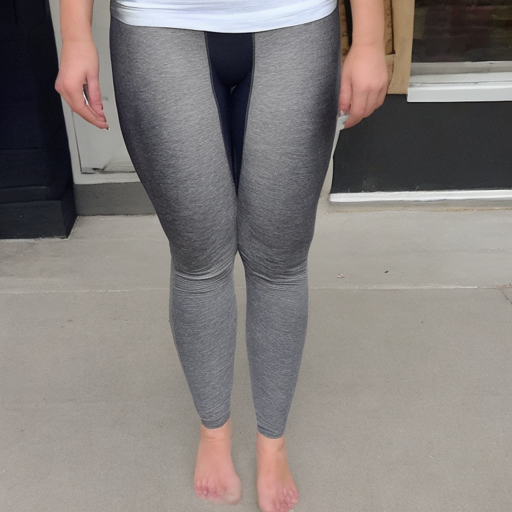

In [ ]:
prompt = "Leggings"
generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : outer, Sweatshirt with Hoodie


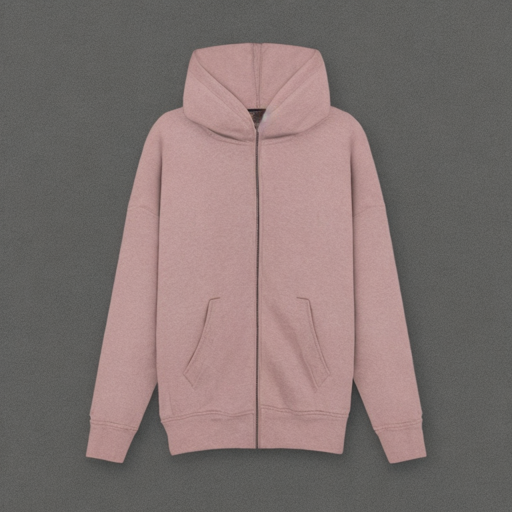

In [ ]:
prompt = "outer, Sweatshirt with Hoodie"
generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : Black Shorts with red and yellow strips


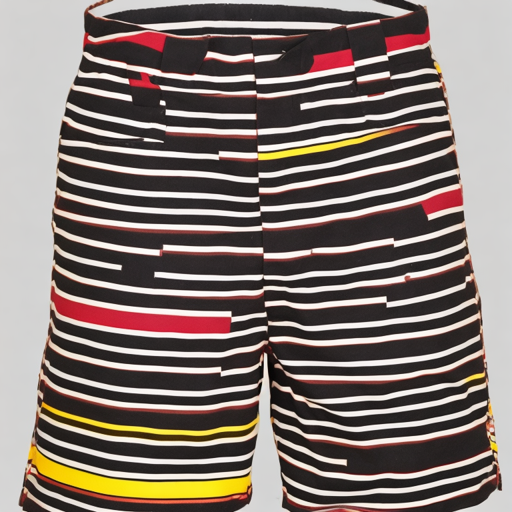

In [ ]:
prompt = "Black Shorts with red and yellow strips"
generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : north face black down jacket


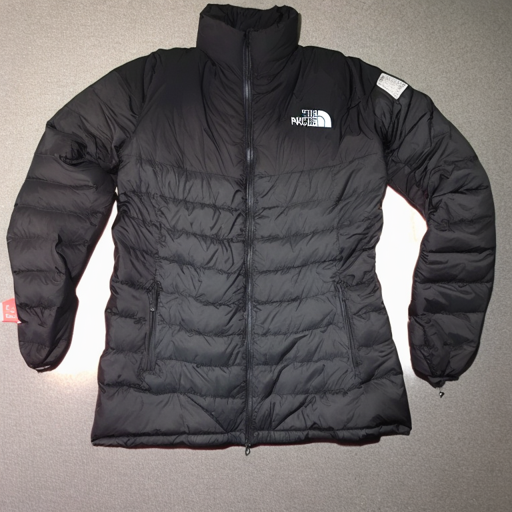

In [ ]:
prompt = "north face black down jacket"
generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : dark blue jean with an animal printing on


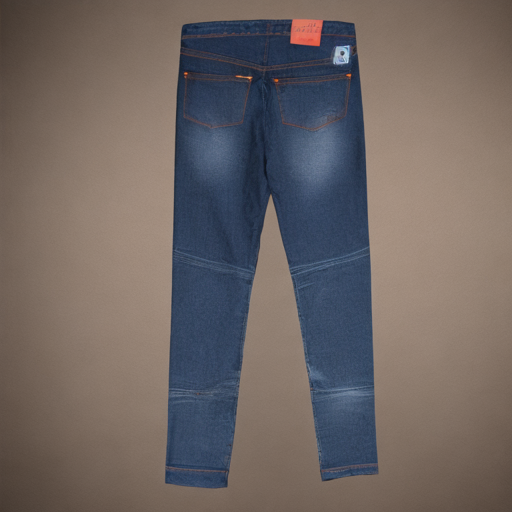

In [ ]:
prompt = "dark blue jean with an animal printing on"
generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : black adidas pants with white stripes


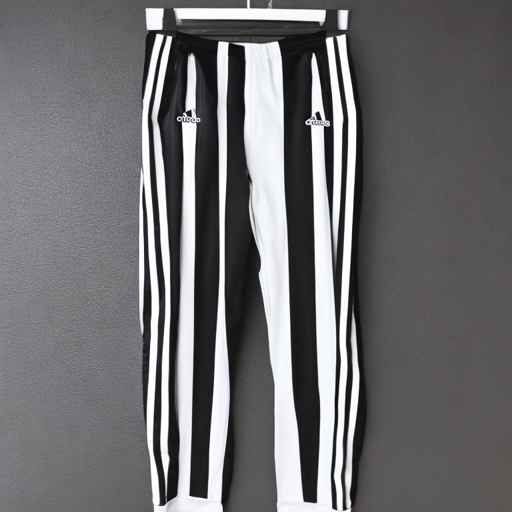

In [ ]:
prompt = "black adidas pants with white stripes"
generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : woman's pants with a plaid pattern


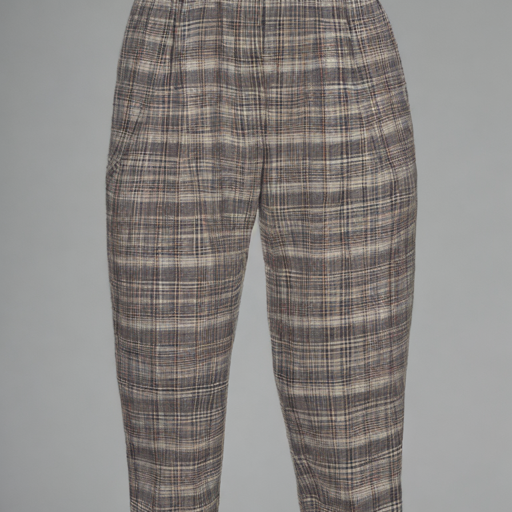

In [ ]:
prompt = "woman's pants with a plaid pattern"
generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : white skirt with blue stars on it


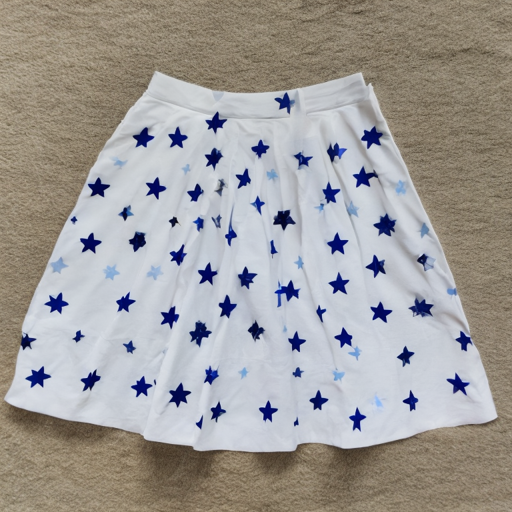

In [ ]:
prompt = "white skirt with blue stars on it"
generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : white puffer jacket with a red box logo on the front


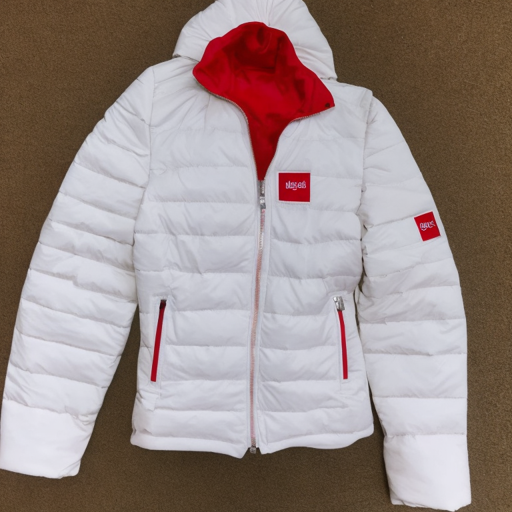

In [ ]:
prompt = "white puffer jacket with a red box logo on the front"
generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : black jacket with white pips and a zippered collar


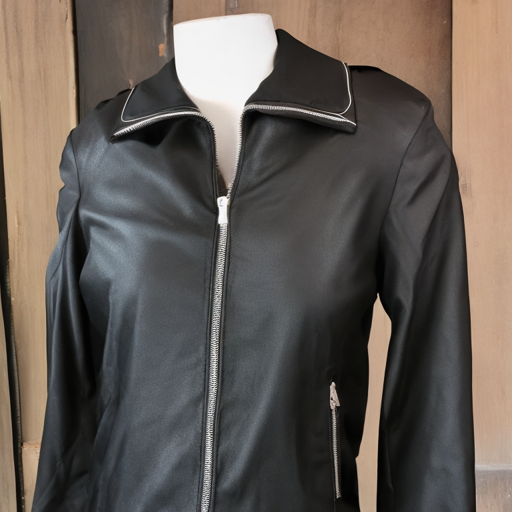

In [ ]:
prompt = "black jacket with white pips and a zippered collar"
generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : outer, black jacket with white pips and a zippered collar


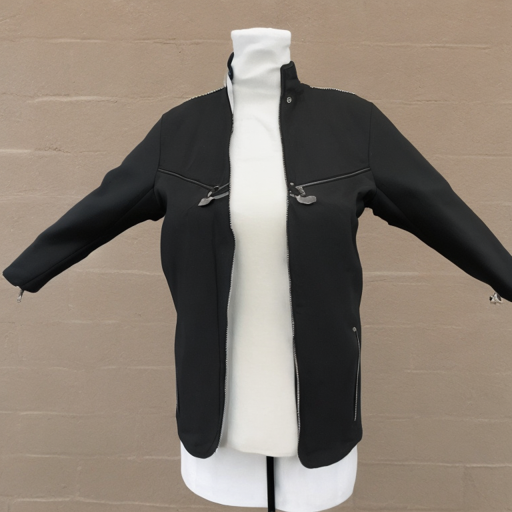

In [ ]:
prompt = "outer, black jacket with white pips and a zippered collar"
generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : outer, black jacket with a white label on it


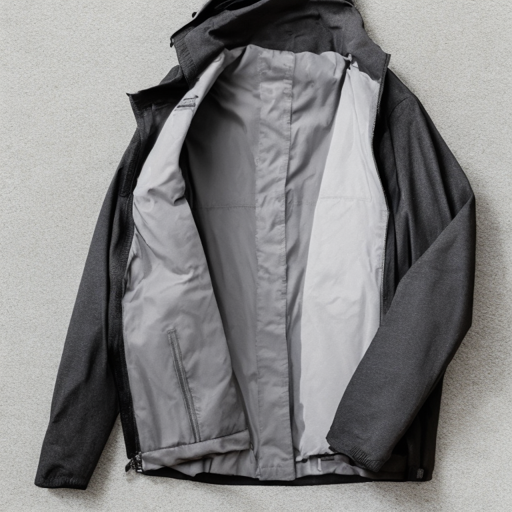

In [ ]:
prompt = "outer, black jacket with a white label on it"
generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : black t - shirt with earth picture print on it


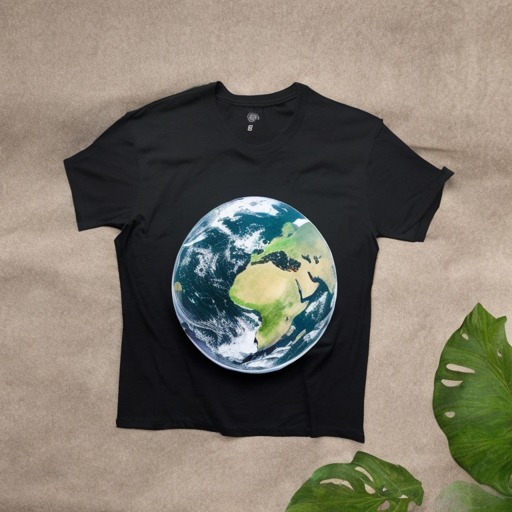

In [ ]:
prompt = "black t - shirt with earth picture print on it"
generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : grey jacket with purple and white stripes


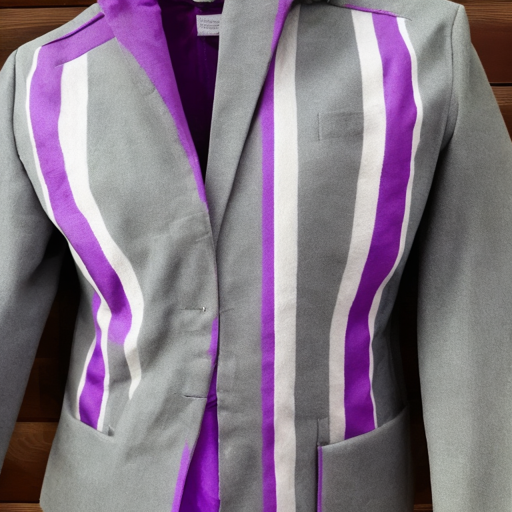

In [ ]:
prompt = "grey jacket with purple and white stripes"
generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : white hoodie with a black cat print on the front


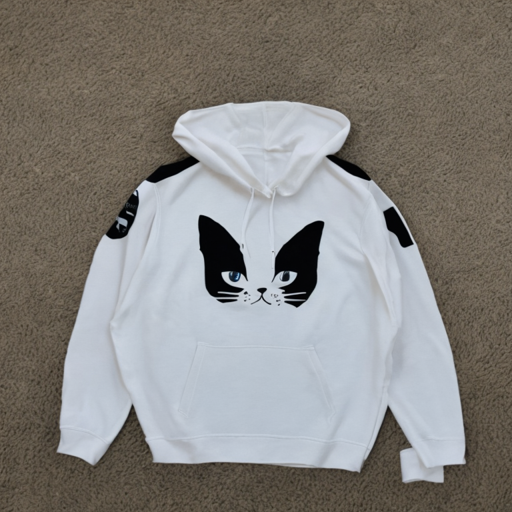

In [ ]:
prompt = "white hoodie with a black cat print on the front"
generated_image(lora_pipeline, prompt)

# **Results before and after fine-tuning**

In [ ]:
def compare_generated_image(pipeline, prompt, scale = 1, num_inference_steps = 50, resize = 512):
  "For Single Prompt"
  image_general = pipeline(prompt, num_inference_steps=50, cross_attention_kwargs={"scale": 0}).images[0]
  image_lora = pipeline(prompt, num_inference_steps=num_inference_steps, cross_attention_kwargs={"scale": scale}).images[0]
  print(f"Prompt : {prompt}")
  print("                          Before fine tuning                                                     After fine tuning                             ")
  # print("                    Before fine tuning                                      After fine tuning                             ")
  return make_image_grid([image_general, image_lora], rows=1, cols=2, resize = resize)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : bottom, Supreme Animal Print Baggy Jean Washed Indigo - 23FW, a photography of a dark blue jean with an animal printing on.
                          Before fine tuning                                                     After fine tuning                             


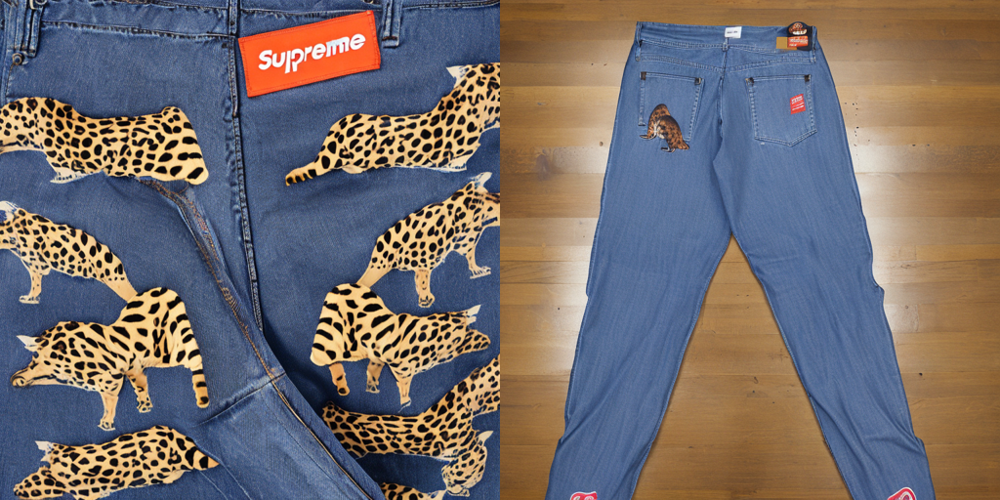

In [ ]:
prompt = "bottom, Supreme Animal Print Baggy Jean Washed Indigo - 23FW, a photography of a dark blue jean with an animal printing on."
compare_generated_image(lora_pipeline, prompt,scale=0.5) # 80% fine tuned weight and 20% pretrained weight

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : outer, The North Face x Supreme White Label Nuptse Down Jacket Cream, a photography of a white puffer jacket with a red box logo on the front.
                          Before fine tuning                                                     After fine tuning                             


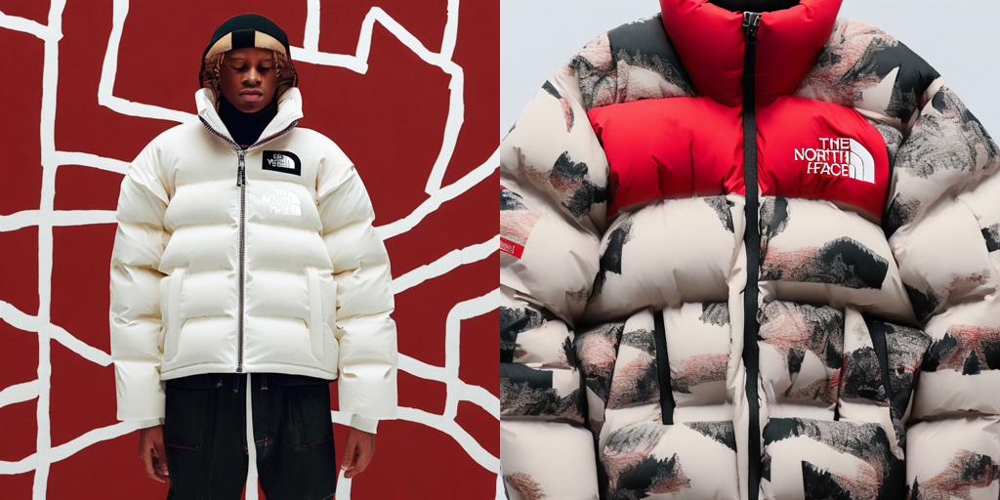

In [ ]:
prompt = "outer, The North Face x Supreme White Label Nuptse Down Jacket Cream, a photography of a white puffer jacket with a red box logo on the front."
compare_generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : white puffer jacket with a red box logo on the front
                          Before fine tuning                                                     After fine tuning                             


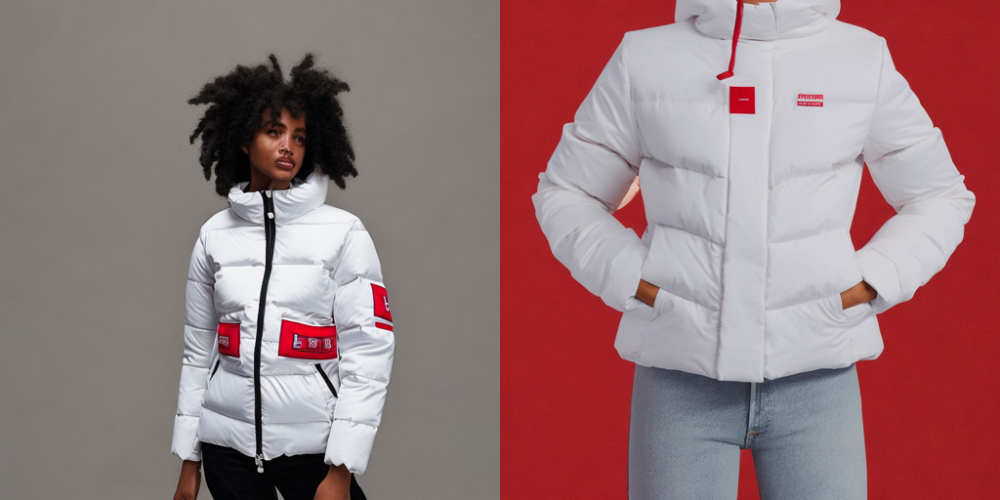

In [ ]:
prompt = "white puffer jacket with a red box logo on the front"
compare_generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : top, Supreme Inside Out Crewneck Black - 23FW, a photography of a supreme sweatshirt with the word supreme on it
                          Before fine tuning                                                     After fine tuning                             


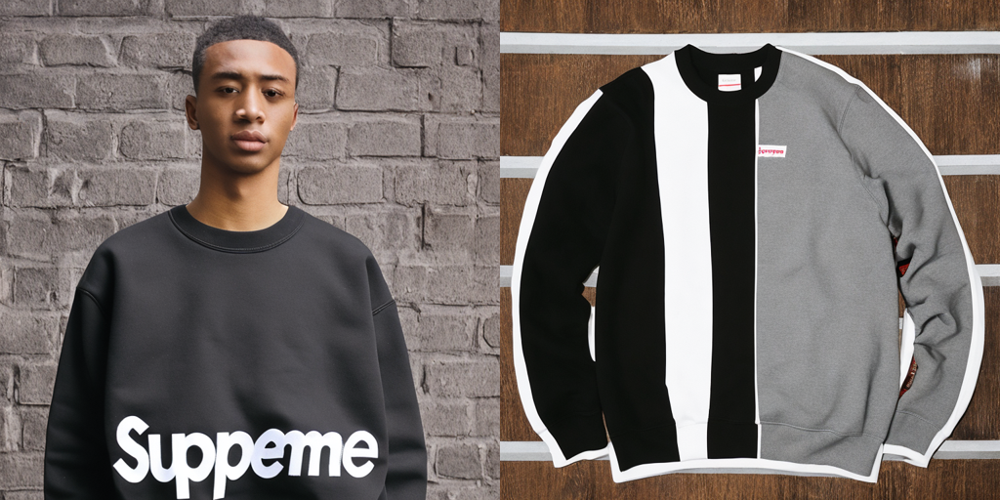

In [ ]:
prompts = "top, Supreme Inside Out Crewneck Black - 23FW, a photography of a supreme sweatshirt with the word supreme on it"
compare_generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : white down jacket with a grey hood
                          Before fine tuning                                                     After fine tuning                             


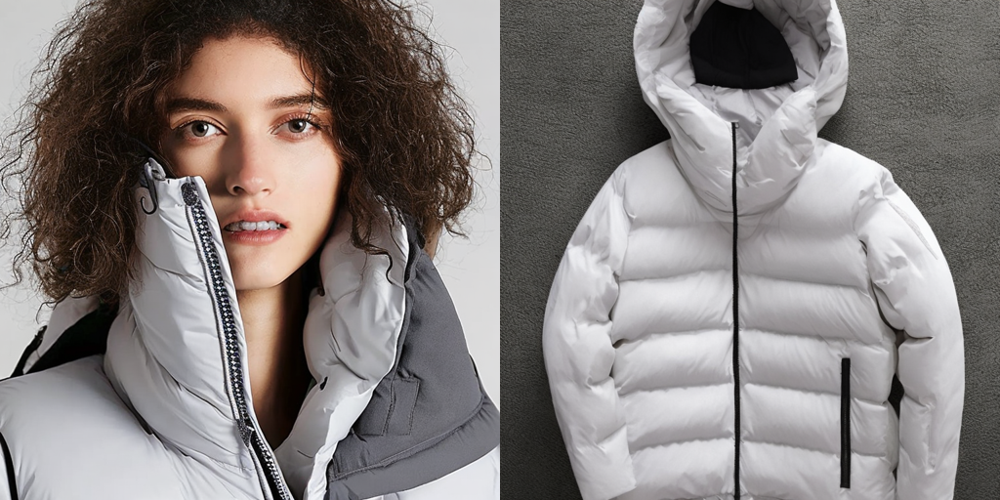

In [ ]:
prompt = "white down jacket with a grey hood"
compare_generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : black leather jacket with a red, white and green stripe
                          Before fine tuning                                                     After fine tuning                             


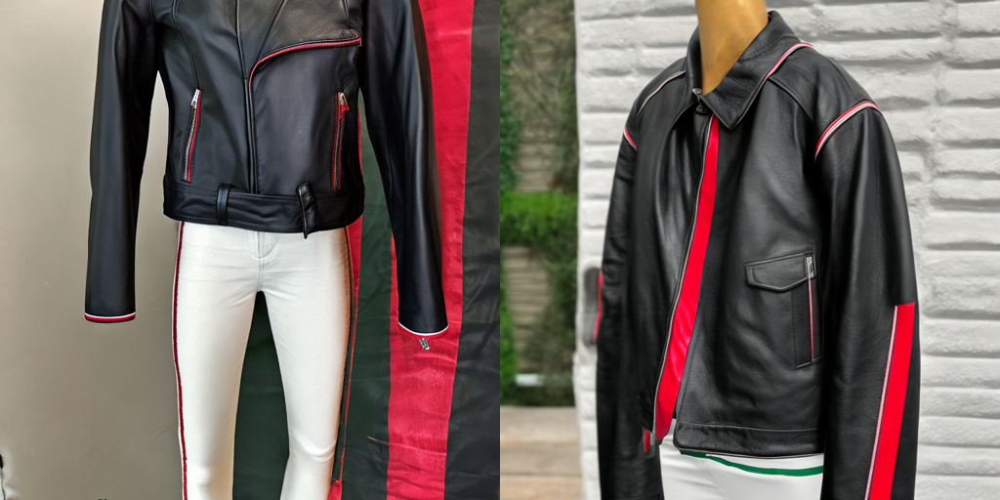

In [ ]:
prompt = "black leather jacket with a red, white and green stripe"
compare_generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : maroon jacket with white stripes
                          Before fine tuning                                                     After fine tuning                             


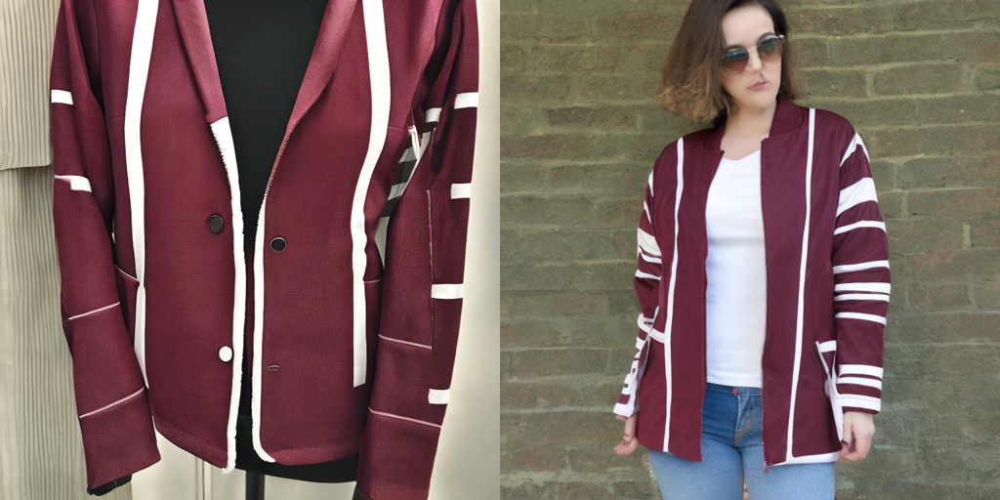

In [ ]:
prompt = "maroon jacket with white stripes"
compare_generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : boy's shorts with orange and brown camouflage print
                          Before fine tuning                                                     After fine tuning                             


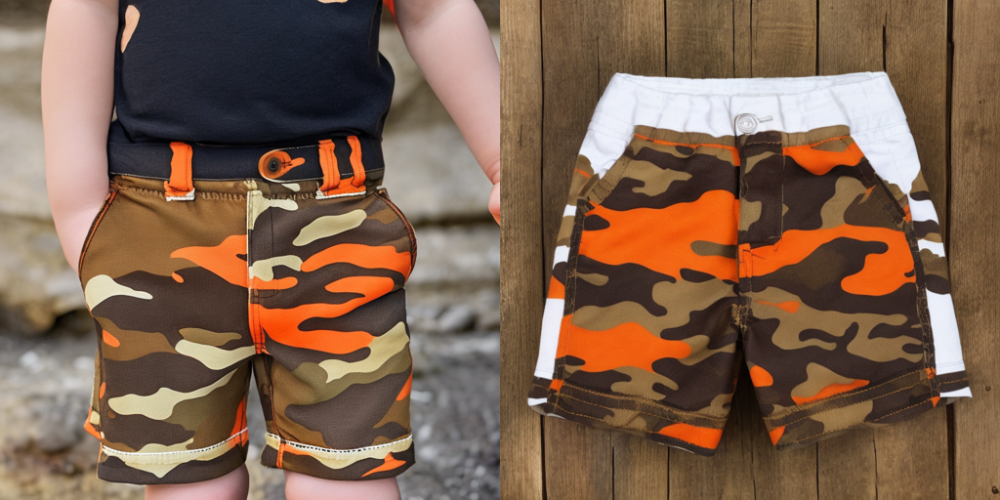

In [ ]:
prompt = "boy's shorts with orange and brown camouflage print"
compare_generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : pair of green jeans
                          Before fine tuning                                                     After fine tuning                             


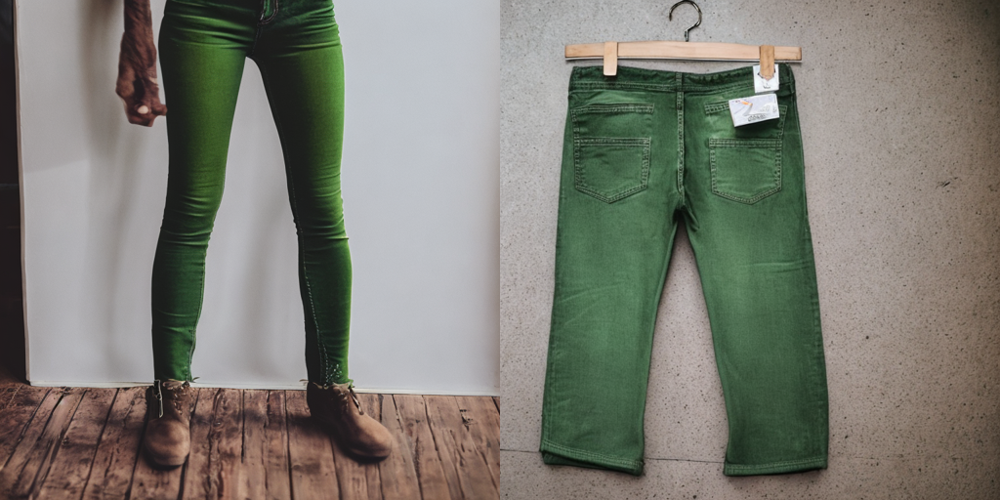

In [ ]:
prompt = "pair of green jeans"
compare_generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : black t - shirt with a teddy bear print on it
                          Before fine tuning                                                     After fine tuning                             


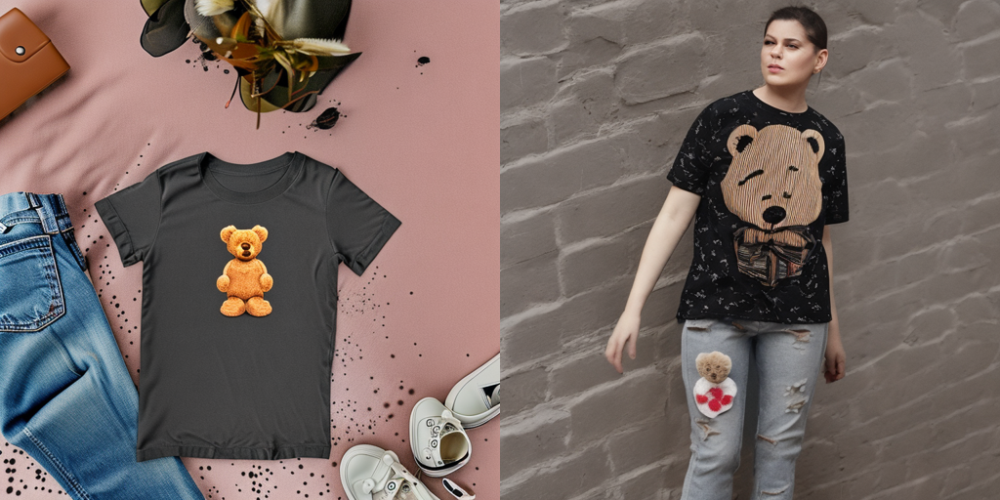

In [ ]:
prompt = "black t - shirt with a teddy bear print on it"
compare_generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : grey sweater with a red heart on the chest
                          Before fine tuning                                                     After fine tuning                             


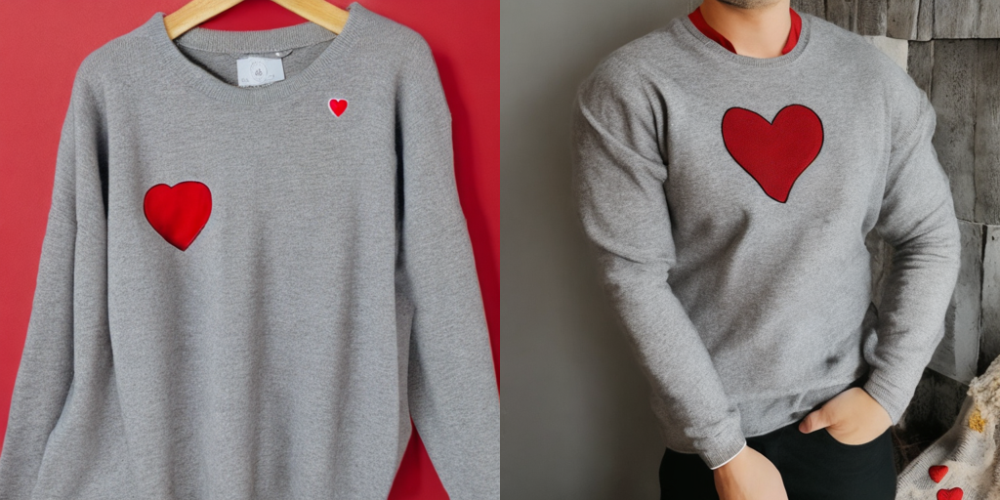

In [ ]:
prompt = "grey sweater with a red heart on the chest"
compare_generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : a yellow and orange sweater with a blue bird on it
                          Before fine tuning                                                     After fine tuning                             


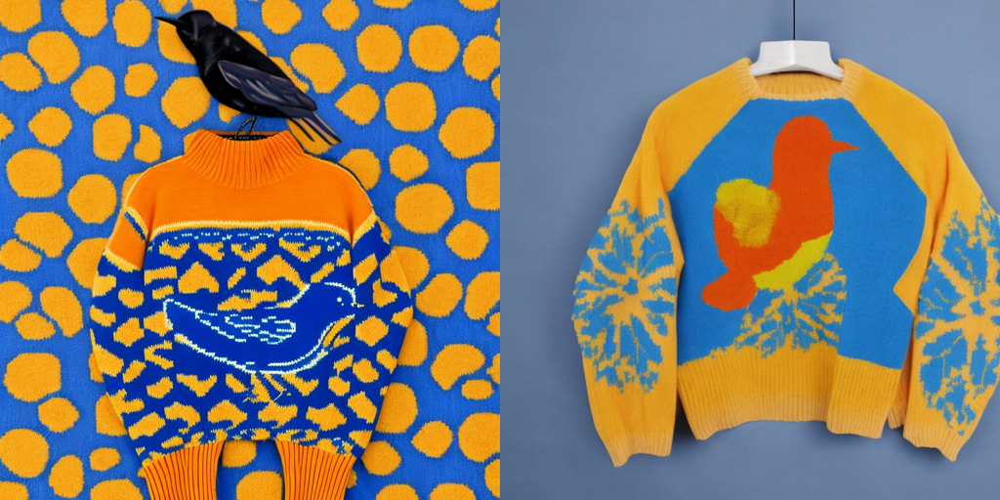

In [ ]:
prompt = "a yellow and orange sweater with a blue bird on it"
compare_generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : black sweatshirt with a colorful print on the front
                          Before fine tuning                                                     After fine tuning                             


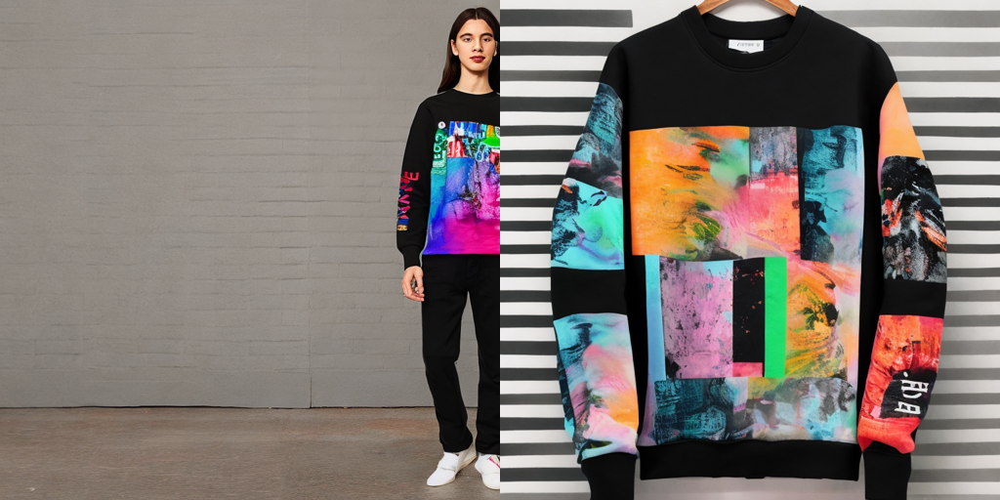

In [ ]:
prompt = "black sweatshirt with a colorful print on the front"
compare_generated_image(lora_pipeline, prompt)

  0%|          | 0/50 [00:00<?, ?it/s]

  0%|          | 0/50 [00:00<?, ?it/s]

Prompt : black pants with white patches
                          Before fine tuning                                                     After fine tuning                             


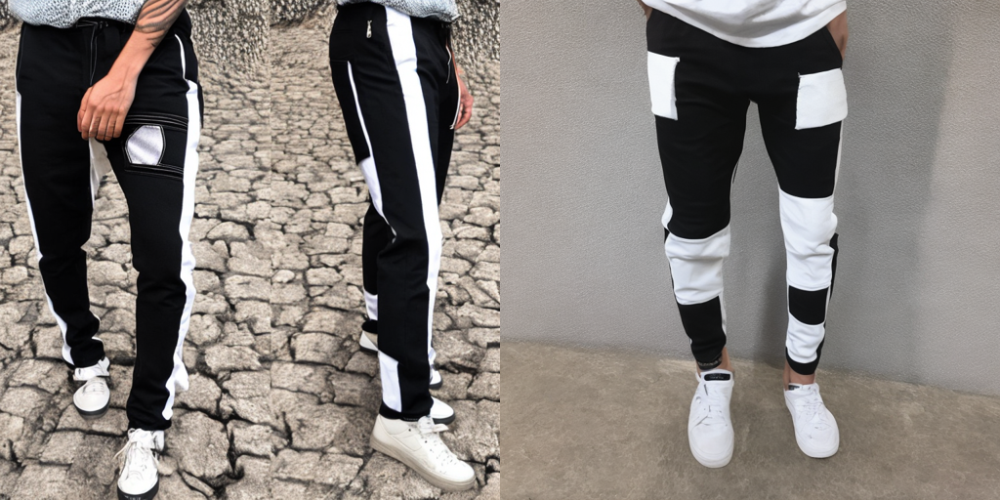

In [ ]:
prompt = "black pants with white patches"
compare_generated_image(lora_pipeline, prompt)